# Import librairies required and define functions


In [ ]:
import numpy as np
import pandas as pd
import soundfile as sf
import librosa
import random
import matplotlib.pyplot as plt
import librosa.display
import tensorflow
import math
import os
import json
import IPython.display as ipd
from IPython.display import Audio
from sklearn.preprocessing import MinMaxScaler

In [ ]:
def spectrogramme(audio):
  S = np.abs(librosa.stft(audio,n_fft = 512)) # Calculer la stft
  S=librosa.amplitude_to_db(S,ref=np.max)
  return S


def spectrogramme_display(audio):

  S = np.abs(librosa.stft(audio, n_fft = 512))
  fig, ax = plt.subplots()
  img = librosa.display.specshow(librosa.amplitude_to_db(S,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
  ax.set_title('Power spectrogram')
  fig.colorbar(img, ax=ax, format="%+2.0f dB")



def bruitage_1son(clean_audio, noise):
 #random number to start noise
 num=random.randint(0, len(noise)-len(clean_audio)) # pour prendre une partie aléatoire du signal de bruit
 RSB=random.random()*6 #noise coeff
 noise=noise[num:num+len(clean_audio)]
 noisy_son=clean_audio + noise* np.sqrt(clean_audio.dot(clean_audio)/noise.dot(noise))*math.pow(10,-RSB/20)

 return noisy_son

def print_plot_play(x, Fs, text=''):

    print('%s Fs = %d, x.shape = %s, x.dtype = %s' % (text, Fs, x.shape, x.dtype))
    plt.figure(figsize=(8, 2))
    plt.plot(x, color='gray')
    plt.xlim([0, x.shape[0]])
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    ipd.display(ipd.Audio(data=x, rate=Fs))

from math import log10
def compute_snr(audio,audio_br): # calcul du RSB du signal
  signal_power = np.mean(audio ** 2)
  m = min(len(audio_br),len(audio))
  noise_power = np.mean((audio_br[0:m] - audio[0:m]) ** 2)
  snr = 10 * log10(signal_power / noise_power)
  return snr

# Noise - example of noising


bruit Fs = 22050, x.shape = (5186831,), x.dtype = float32


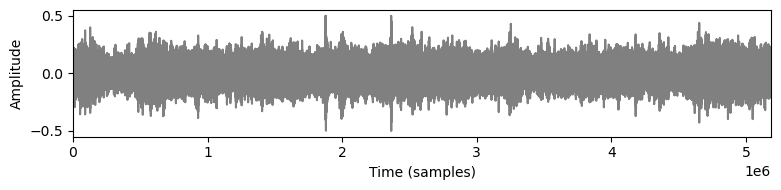

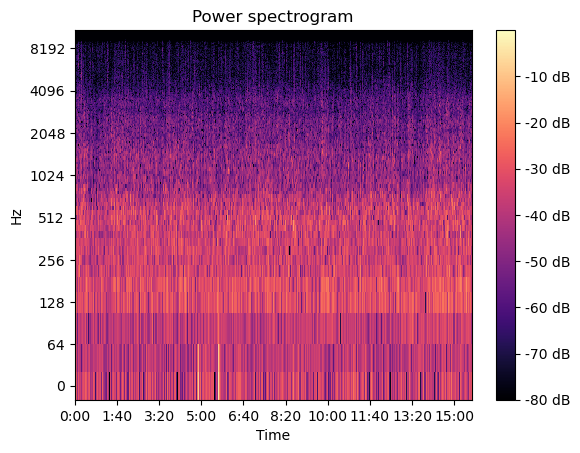

In [ ]:
noise, sr = librosa.load('data_sil/babble.wav')
print_plot_play(noise, sr, text='bruit')
spectrogramme_display(noise)

audio avant bruitage Fs = 22050, x.shape = (88641,), x.dtype = float32


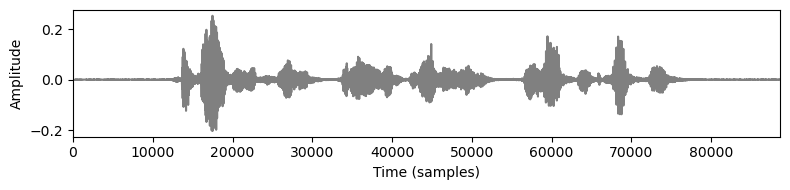

In [ ]:
#bruitage d'un fichier:
data1, sr1 = librosa.load('data_sil/174-50561-0000.flac')
noisy1 = bruitage_1son(data1, noise)
#play original audio
print_plot_play(data1, sr1, text='audio avant bruitage')

audio après bruitage Fs = 22050, x.shape = (88641,), x.dtype = float32


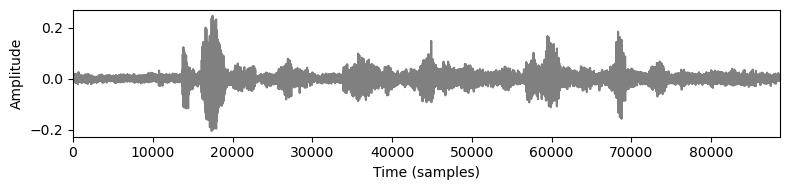

In [ ]:
#play noisy audio
print_plot_play(noisy1, sr1, text='audio après bruitage')

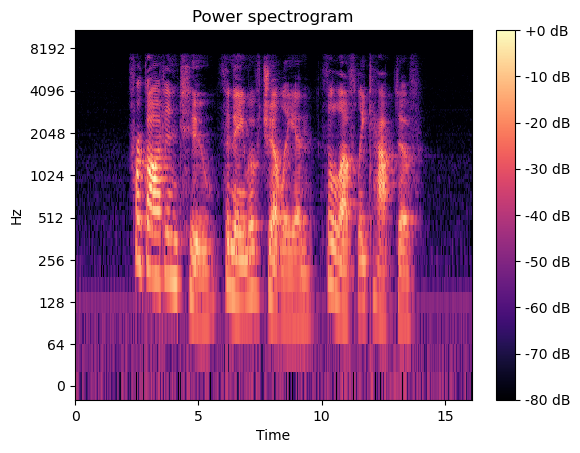

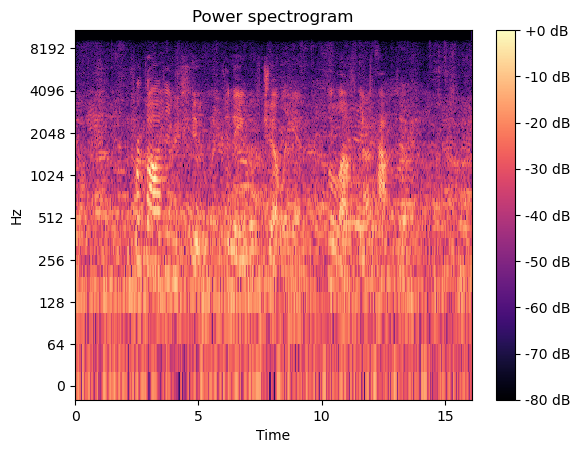

In [ ]:
#affichage des spectrogrammes (echelle log)
spectrogramme_display(data1)
spectrogramme_display(noisy1)

# Creation de la base de données

In [ ]:
def creation_spects(folder_path):

  global noisySTFT , cleanSTFT
  shape_ = []
  l=[]
  noisySTFT=[]
  cleanSTFT=[]

  for path, dirs, files in os.walk(folder_path):
    for filename in files:

      path_file = folder_path +'/'+ filename
      audio, sr = librosa.load(path_file)
      duration = librosa.get_duration(y=audio, sr=sr)
      l.append(duration)
      print(filename)

      bruite = bruitage_1son(audio, noise)
      spect_bruite = (np.abs(librosa.stft(bruite,n_fft=512)))
      shape_.append(np.shape(spect_bruite)[1])
      noisySTFT.append(spect_bruite)

      cleanSTFT.append((np.abs(librosa.stft(audio,n_fft=512))))
  max_spect = np.max(shape_)
  total_duration = sum(l)/60
  return noisySTFT, cleanSTFT , max_spect , total_duration

def creation_data(cleanSTFT, noisySTFT,max_spect):


  data = {
      "SpectClean" : [], "SpectBruite" : []
   }

  clean=np.pad(cleanSTFT[0], ((0, 0), (0, max-np.shape(cleanSTFT[0])[1])), 'constant', constant_values=0)
  noisy=np.pad(noisySTFT[0], ((0, 0), (0, max-np.shape(cleanSTFT[0])[1])), 'constant', constant_values=0)


  for i in range (1,len(cleanSTFT)):
    shape_ = np.shape(cleanSTFT[i])[1]
    #shape_1 = np.shape(cleanSTFT[i])[1]
    if ( shape_ < max):
      pad = np.pad(cleanSTFT[i], ((0, 0), (0, max-shape_)), 'constant', constant_values=0)
      pad1 = np.pad(noisySTFT[i], ((0, 0), (0, max-shape_)), 'constant', constant_values=0)

      clean = np.append(clean,pad,axis=1)
      noisy = np.append(noisy,pad1,axis=1)
       #file
  data['SpectClean'].append(clean.tolist())
  data['SpectBruite'].append(noisy.tolist())
  print('Fichier data.json créé avec succès')
  return noisy , clean

def json_to_data(file):
  with open("data.json", "r") as infile:
    df = json.load(infile)
  X = np.array(df['SpectBruite'])
  y = np.array(df['SpectClean'])
  X = X.reshape(X.shape[1],X.shape[2])
  y = y.reshape(y.shape[1],y.shape[2])
  X = X.transpose()
  y = y.transpose()
  print('shape of X is',np.shape(X))
  print('shape of y is',np.shape(y))

  return X , y


def scale_data(X_tr,y_tr,X_te,y_te):
  scaler = MinMaxScaler()
  scaler.fit(X_tr)
  X_train = scaler.transform(X_tr)
  X_test = scaler.transform(X_te)
  #scaling y
  scaler1 = MinMaxScaler()
  scaler1.fit(y_tr)

  y_train = scaler1.transform(y_tr)
  y_test = scaler1.transform(y_te)
  return X_train , y_train , X_test , y_test

In [ ]:
folder_path='data_sil/data'
N, C , max , l = creation_spects(folder_path)
print('The largest spectrogram is of length',max)
print('total duration of data',l,'min')



174-168635-0007.flac
174-168635-0008.flac
174-168635-0009.flac
174-168635-0010.flac
174-168635-0011.flac
174-168635-0012.flac
174-168635-0013.flac
174-168635-0014.flac
174-168635-0015.flac
174-168635-0016.flac
174-168635-0017.flac
174-168635-0018.flac
174-168635-0019.flac
174-168635-0020.flac
174-168635-0021.flac
174-168635-0022.flac
174-50561-0000.flac
1919-142785-0037.flac
1919-142785-0038.flac
1919-142785-0039.flac
1919-142785-0040.flac
1919-142785-0041.flac
1919-142785-0042.flac
1919-142785-0043.flac
1919-142785-0044.flac
1919-142785-0045.flac
1919-142785-0046.flac
1919-142785-0047.flac
1919-142785-0048.flac
1919-142785-0049.flac
1919-142785-0050.flac
1919-142785-0051.flac
1919-142785-0052.flac
1919-142785-0053.flac
1919-142785-0054.flac
1988-147956-0000.flac
1988-147956-0001.flac
1988-147956-0002.flac
1988-147956-0003.flac
1988-147956-0004.flac
1988-147956-0005.flac
1988-147956-0006.flac
1988-147956-0007.flac
1988-147956-0008.flac
1988-147956-0009.flac
1988-147956-0010.flac
1988-1

In [ ]:
data = {
      "SpectClean" : [], "SpectBruite" : []
   }

clean=C[0]
noisy=N[0]


for i in range (1,len(cleanSTFT)):

      clean = np.append(clean,C[i],axis=1)
      noisy = np.append(noisy,N[i],axis=1)
       #file
data['SpectClean'].append(clean.tolist())
data['SpectBruite'].append(noisy.tolist())


In [ ]:
X = np.array(data['SpectBruite'])
y = np.array(data['SpectClean'])
X = X.reshape(X.shape[1],X.shape[2])
y = y.reshape(y.shape[1],y.shape[2])
X = X.transpose()
y = y.transpose()
print('shape of X is',np.shape(X))
print('shape of y is',np.shape(y))

shape of X is (525084, 257)
shape of y is (525084, 257)


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print('shape of X_train is',np.shape(X_train))
print('shape of X_test is',np.shape(X_test))
print('shape of y_train is',np.shape(y_train))
print('shape of y_test is',np.shape(y_test))

shape of X_train is (420067, 257)
shape of X_test is (105017, 257)
shape of y_train is (420067, 257)
shape of y_test is (105017, 257)


In [ ]:
scaler = MinMaxScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)
  #scaling y
scaler1 = MinMaxScaler()
scaler1.fit(y_train)

y_train = scaler1.transform(y_train)
y_test = scaler1.transform(y_test)

# CV param tuning

In [ ]:
from sklearn.model_selection import GridSearchCV
import keras
from keras.wrappers.scikit_learn import KerasRegressor
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization


# Define the model
def create_model(learn_rate=0.01, activation='relu'):
    model = Sequential()
    model.add(Dense(257, activation = activation, input_shape=(257,)))
    model.add(Dense(257, activation='relu'))
    optimiser = keras.optimizers.Adam(learning_rate=learn_rate)
    model.compile(optimizer = 'adam', loss='mean_squared_error',metrics=['accuracy'])
    return model

# Create the model wrapper
model = KerasRegressor(build_fn=create_model, epochs=100, batch_size=320, verbose=0)

# Define the parameter grid
param_grid = {'learn_rate': [0.001, 0.01, 0.1],
              'activation':['relu','linear']}



grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3)
grid_search.fit(X_train, y_train)

C:\Users\etudiant\AppData\Local\Temp\ipykernel_904\2621482556.py:18: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasRegressor(build_fn=create_model, epochs=100, batch_size=320, verbose=0)


In [ ]:
# print the best parameters
print("Best: %f using %s" % (grid_search.best_score_, grid_search.best_params_))

Best: -0.056776 using {'activation': 'relu', 'batch_size': 700, 'learn_rate': 0.01}


In [ ]:
#model
import  keras as keras
from  keras.layers import Dropout
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization

ff_best = keras.Sequential([
  Dense(257, activation='relu', input_shape=(257,)),
  #Dense(257, activation='relu'),
  Dense(257, activation='relu'),
  Dense(257, activation='relu'),
  Dense(257, activation='relu'),

])

optimiser = keras.optimizers.Adam(learning_rate=0.001)
ff_best.compile(optimizer = 'adam', loss='mean_squared_error',metrics=['MSE'])
ff_best.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 257)               66306     
                                                                 
 dense_1 (Dense)             (None, 257)               66306     
                                                                 
 dense_2 (Dense)             (None, 257)               66306     
                                                                 
 dense_3 (Dense)             (None, 257)               66306     
                                                                 
Total params: 265,224
Trainable params: 265,224
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history = ff_best.fit(X_train , y_train , validation_data = (X_test,y_test), batch_size=3000,epochs=100)

Epoch 1/100
40/40 [==============================] - 3s 16ms/step - loss: 0.4132 - MSE: 0.4132 - val_loss: 0.2223 - val_MSE: 0.2223
Epoch 2/100
40/40 [==============================] - 0s 9ms/step - loss: 0.1896 - MSE: 0.1896 - val_loss: 0.1665 - val_MSE: 0.1665
Epoch 3/100
40/40 [==============================] - 0s 8ms/step - loss: 0.1558 - MSE: 0.1558 - val_loss: 0.1468 - val_MSE: 0.1468
Epoch 4/100
40/40 [==============================] - 0s 9ms/step - loss: 0.1409 - MSE: 0.1409 - val_loss: 0.1368 - val_MSE: 0.1368
Epoch 5/100
40/40 [==============================] - 0s 8ms/step - loss: 0.1321 - MSE: 0.1321 - val_loss: 0.1316 - val_MSE: 0.1316
Epoch 6/100
40/40 [==============================] - 0s 8ms/step - loss: 0.1264 - MSE: 0.1264 - val_loss: 0.1267 - val_MSE: 0.1267
Epoch 7/100
40/40 [==============================] - 0s 8ms/step - loss: 0.1219 - MSE: 0.1219 - val_loss: 0.1228 - val_MSE: 0.1228
Epoch 8/100
40/40 [==============================] - 0s 8ms/step - loss: 0.1183 - 

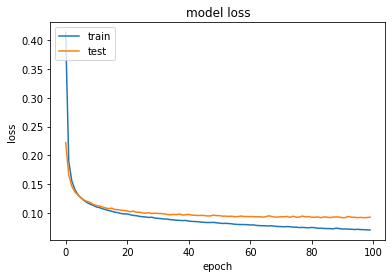

In [ ]:

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')




In [ ]:
#test of the model on one audio
#audio, sr = librosa.load('data/3000-15664-0027.flac')

audio, sr = librosa.load('422-122949-0010.flac')
clean_stft = librosa.stft(audio,n_fft=512)

bruite = bruitage_1son(audio, noise)
l= librosa.stft(bruite,n_fft=512)
noisy_am, noisy_ph = librosa.magphase(l)

clean_am, clean_ph = librosa.magphase(clean_stft)

predicted= ff_best.predict(noisy_am.transpose())
predicted = predicted.transpose()* noisy_ph

signal1 = librosa.istft(predicted)
print(np.shape(librosa.amplitude_to_db(np.abs(librosa.stft(audio,n_fft=512)))))
print(np.shape(signal.transpose()))



175/175 [==============================] - 0s 1ms/step
(257, 5589)
(714112,)


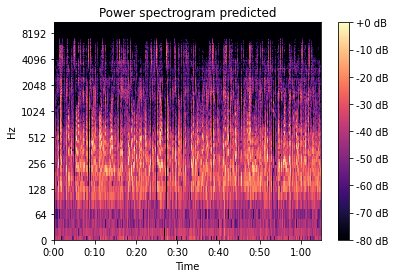

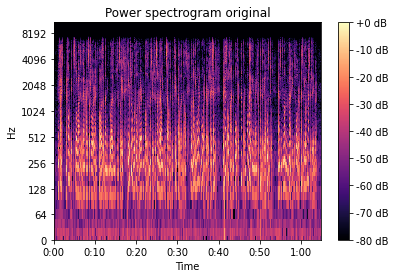

In [ ]:
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(signal1,n_fft=1024)),
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram predicted')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

S = np.abs(librosa.stft(audio,n_fft=1024))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(S,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram original')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

/usr/local/lib/python3.8/dist-packages/librosa/core/spectrum.py:1641: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  warnings.warn(


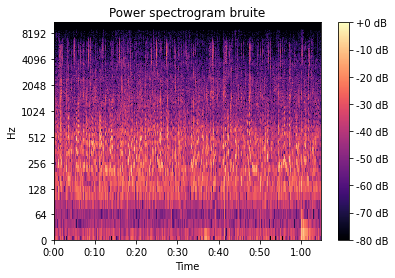

In [ ]:
l= librosa.stft(bruite,n_fft=1024)

fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(l,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram bruite')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

audio débruité prédit Fs = 22050, x.shape = (715264,), x.dtype = float32


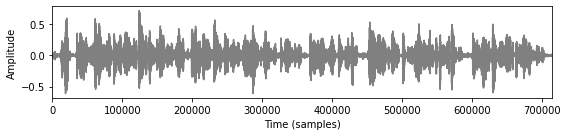

In [ ]:
print_plot_play(signal1, sr, text='audio débruité prédit')

audio réel  Fs = 22050, x.shape = (190953,), x.dtype = float32


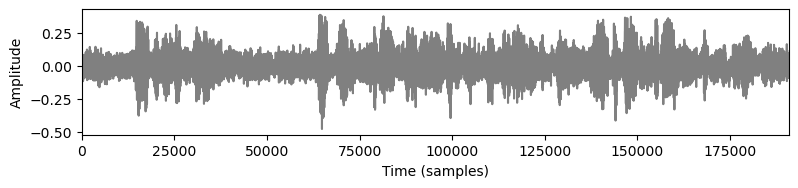

In [ ]:
print_plot_play(bruite, sr, text='audio réel ')

In [ ]:
snr_before= compute_snr(audio,bruite)
snr_after = compute_snr(audio,signal1)
print('SNR_before',snr_before)
print('SNR_after',snr_after)
print(snr_after-snr_before)

SNR_before 1.6742900830508733
SNR_after 6.487218960824044
4.812928877773171


In [ ]:
def gain_SNR(folder_path):
    SNR_before=[]
    SNR_after=[]
    G = []
    for path, dirs, files in os.walk(folder_path):
        for filename in files:
            #print("mama")
            path_file = folder_path +'/'+ filename
            audio, sr = librosa.load(path_file)
            clean_stft = librosa.stft(audio,n_fft=512)

            bruite = bruitage_1son(audio, noise)
            l= librosa.stft(bruite,n_fft=512)
            noisy_am, noisy_ph = librosa.magphase(l)

            clean_am, clean_ph = librosa.magphase(clean_stft)

            predicted= ff_best.predict(noisy_am.transpose())
            predicted = predicted.transpose()* noisy_ph

            signal = librosa.istft(predicted)
            snr_before= compute_snr(audio,bruite)
            snr_after = compute_snr(audio,signal)
            gain = snr_after - snr_before
            SNR_before.append(snr_before)
            SNR_after.append(snr_after)
            G.append(gain)
    return SNR_before , SNR_after , G

folder_path = 'test'
S_in , S_out , G = gain_SNR(folder_path)
print('SNR before', np.mean(S_in))
print('SNR after', np.mean(S_out))
print('Gain', np.mean(G))

32/32 [==============================] - 0s 1ms/step
SNR before 2.775160009871116
SNR after 7.498469219779369
Gain 4.723309209908251


In [ ]:
#from keras.models import model_from_json

# serialize model to JSON
model_json = ff_best.to_json()

with open("model_ff.json", "w") as json_file:
    json_file.write(model_json)

# save weights to HDF5
ff_best.save_weights("model_ff.h5")
print("Model saved")


Model saved


# LSTM denoiser


In [ ]:
from tensorflow import keras
from keras import Model
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, LSTM


lstm_out = 257

time_step= 10
shape_train =(np.shape(X_train)[0])//time_step
shape_test =(np.shape(X_test)[0])//time_step
max_train = shape_train * time_step
max_test= shape_test * time_step

X3d_train = X_train[:max_train,:]
X3d_train = np.reshape(X3d_train, (shape_train,time_step,257))
Y3d_train = y_train[:max_train,:]
Y3d_train = np.reshape(Y3d_train,(shape_train,time_step,257))

X3d_test = X_test[:max_test,:]
X3d_test = np.reshape(X3d_test, (shape_test,time_step,257))
Y3d_test = y_test[:max_test,:]
Y3d_test = np.reshape(Y3d_test,(shape_test,time_step,257))


model = Sequential()
model.add(Dense(257,activation='ReLU'))
model.add(LSTM(lstm_out, dropout = 0.01, return_sequences=True ,input_shape=(time_step,257)))
model.add(LSTM(lstm_out, dropout = 0.1, return_sequences=True ,input_shape=(time_step,257)))
model.add(Dense(257,activation='ReLU'))
model.add(Dense(257,activation='ReLU'))

optimiser = keras.optimizers.Adam(learning_rate=0.01)
model.compile(optimizer = 'adam', loss='mean_squared_error',metrics=['MSE'])


In [ ]:
hstr=model.fit(X3d_train , Y3d_train , validation_data = (X3d_test,Y3d_test),batch_size=3000,epochs=150)

Epoch 1/150
4/4 [==============================] - 5s 399ms/step - loss: 0.8490 - MSE: 0.8490 - val_loss: 0.7804 - val_MSE: 0.7804
Epoch 2/150
4/4 [==============================] - 1s 136ms/step - loss: 0.7624 - MSE: 0.7624 - val_loss: 0.7098 - val_MSE: 0.7098
Epoch 3/150
4/4 [==============================] - 1s 139ms/step - loss: 0.7075 - MSE: 0.7075 - val_loss: 0.6718 - val_MSE: 0.6718
Epoch 4/150
4/4 [==============================] - 1s 140ms/step - loss: 0.6695 - MSE: 0.6695 - val_loss: 0.6252 - val_MSE: 0.6252
Epoch 5/150
4/4 [==============================] - 1s 136ms/step - loss: 0.6159 - MSE: 0.6159 - val_loss: 0.5703 - val_MSE: 0.5703
Epoch 6/150
4/4 [==============================] - 1s 140ms/step - loss: 0.5740 - MSE: 0.5740 - val_loss: 0.5525 - val_MSE: 0.5525
Epoch 7/150
4/4 [==============================] - 1s 142ms/step - loss: 0.5566 - MSE: 0.5566 - val_loss: 0.5372 - val_MSE: 0.5372
Epoch 8/150
4/4 [==============================] - 1s 146ms/step - loss: 0.5453 - M

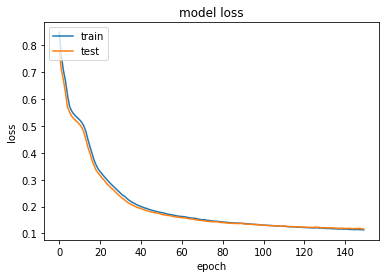

In [ ]:
plt.plot(hstr.history['loss'])
plt.plot(hstr.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')


In [ ]:
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_22 (Dense)            (None, 10, 257)           66306     
                                                                 
 lstm_8 (LSTM)               (None, 10, 257)           529420    
                                                                 
 lstm_9 (LSTM)               (None, 10, 257)           529420    
                                                                 
 dense_23 (Dense)            (None, 10, 257)           66306     
                                                                 
 dense_24 (Dense)            (None, 10, 257)           66306     
                                                                 
Total params: 1,257,758
Trainable params: 1,257,758
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#test of the model on one audio
audio, sr = librosa.load('422-122949-0010.flac')
clean_stft = librosa.stft(audio,n_fft=512)

bruite = bruitage_1son(audio, noise)
l= librosa.stft(bruite,n_fft=512)
noisy_am, noisy_ph = librosa.magphase(l)
nn =(np.shape(noisy_am)[1])//time_step
noisy_am = noisy_am[:,:nn*time_step]

noisy_am = noisy_am.transpose()
noisy_ph = noisy_ph[:,:nn*time_step]

noisy_am = noisy_am.reshape(nn,time_step,257)
predicted= model.predict(noisy_am)
predicted =predicted.reshape(nn*time_step,257)
mod = predicted.transpose()
predicted = predicted.transpose()* noisy_ph
signal = librosa.istft(predicted)




18/18 [==============================] - 0s 5ms/step


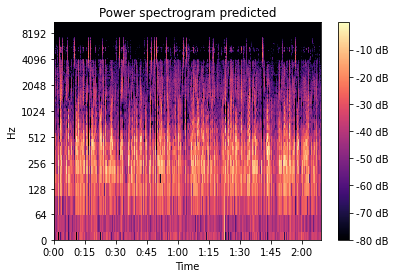

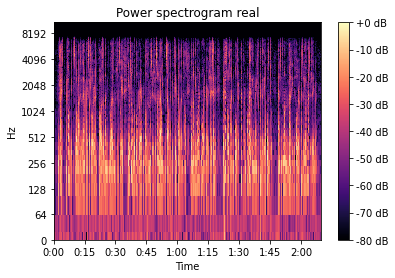

In [ ]:
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(signal,n_fft=512)),
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram predicted')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

S = np.abs(librosa.stft(audio,n_fft=512))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(S,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram real')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

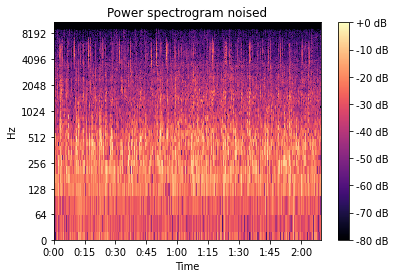

In [ ]:
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(bruite,n_fft=512)),
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram noised')
fig.colorbar(img, ax=ax, format="%+2.0f dB")


audio débruité prédit Fs = 22050, x.shape = (714112,), x.dtype = float32


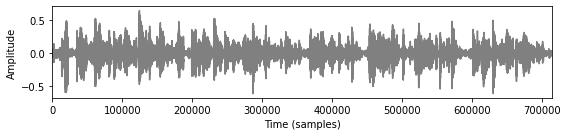

In [ ]:
print_plot_play(signal, sr, text='audio débruité prédit')

In [ ]:
snr_before= compute_snr(audio,bruite)
snr_after = compute_snr(audio,signal)

print('SNR_before',snr_before)
print('SNR_after',snr_after)
print('Gain',snr_after-snr_before)

SNR_before 1.3927866676608716
SNR_after 7.2824990832126
Gain 5.889712415551728


10/10 [==============================] - 0s 5ms/step


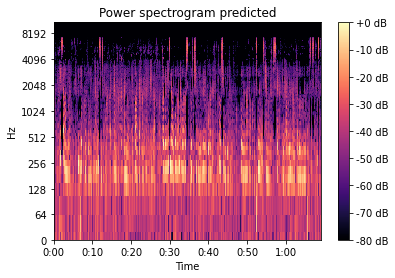

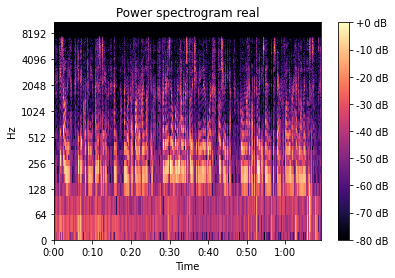

In [ ]:
#test of the model on one audio
audio, sr = librosa.load('3576-138058-0017.flac')
clean_stft = librosa.stft(audio,n_fft=512)

bruite = bruitage_1son(audio, noise)
l= librosa.stft(bruite,n_fft=512)
noisy_am, noisy_ph = librosa.magphase(l)
nn =(np.shape(noisy_am)[1])//time_step
noisy_am = noisy_am[:,:nn*time_step]

noisy_am = noisy_am.transpose()
noisy_ph = noisy_ph[:,:nn*time_step]

noisy_am = noisy_am.reshape(nn,time_step,257)
predicted= model.predict(noisy_am)
predicted =predicted.reshape(nn*time_step,257)
mod = predicted.transpose()
predicted = predicted.transpose()* noisy_ph
signal = librosa.istft(predicted)
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(signal,n_fft=512)),
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram predicted')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

S = np.abs(librosa.stft(audio,n_fft=512))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(S,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax)
ax.set_title('Power spectrogram real')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

audio débruité prédit Fs = 22050, x.shape = (381312,), x.dtype = float32


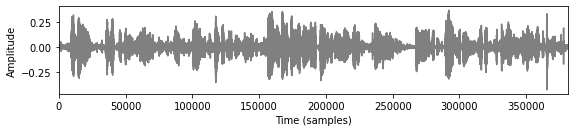

In [ ]:
print_plot_play(signal, sr, text='audio débruité prédit')

audio débruité prédit Fs = 22050, x.shape = (382017,), x.dtype = float32


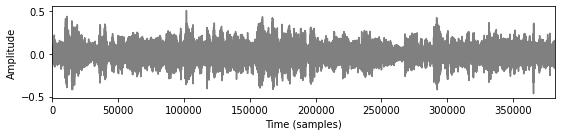

In [ ]:
print_plot_play(bruite, sr, text='audio bruité ')

In [ ]:
snr_before= compute_snr(audio,bruite)
snr_after = compute_snr(audio,signal)

print('SNR_before',snr_before)
print('SNR_after',snr_after)
print('Gain',snr_after-snr_before)

SNR_before 2.086153301425349
SNR_after 7.558342936449724
Gain 5.472189635024375


In [ ]:
def gain_SNR_LSTM(folder_path):
  SNR_before=[]
  SNR_after=[]
  G = []
  for path, dirs, files in os.walk(folder_path):
      for filename in files:

        path_file = folder_path +'/'+ filename
        audio, sr = librosa.load(path_file)
        clean_stft = librosa.stft(audio,n_fft=512)

        bruite = bruitage_1son(audio, noise)
        l= librosa.stft(bruite,n_fft=512)
        clean_am, clean_ph = librosa.magphase(clean_stft)
        noisy_am, noisy_ph = librosa.magphase(l)
        nn =(np.shape(noisy_am)[1])//time_step
        noisy_am = noisy_am[:,:nn*time_step]
        noisy_am = noisy_am.transpose()
        noisy_ph = noisy_ph[:,:nn*time_step]

        noisy_am = noisy_am.reshape(nn,time_step,257)

        predicted= model.predict(noisy_am)
        predicted =predicted.reshape(nn*time_step,257)
        predicted = predicted.transpose()* noisy_ph

        signal = librosa.istft(predicted)
        bruite_tronc= bruite
        snr_before= compute_snr(audio,bruite_tronc)
        snr_after = compute_snr(audio,signal)
        gain = snr_after - snr_before
        SNR_before.append(snr_before)
        SNR_after.append(snr_after)
        G.append(gain)
  return SNR_before , SNR_after , G


folder_path = 'test_data'
S_in , S_out , G = gain_SNR_LSTM(folder_path)
print('SNR before', np.mean(S_in))
print('SNR after', np.mean(S_out))
print('Gain', np.mean(G))

9/9 [==============================] - 0s 5ms/step
SNR before 2.9421015127902783
SNR after 7.539253705452301
Gain 6.3197209647141195


In [ ]:
#from keras.models import model_from_json

# serialize model to JSON
model_json = model.to_json()

with open("lstm.json", "w") as json_file:
    json_file.write(model_json)

# save weights to HDF5
model.save_weights("lstm.h5")
print("Model saved")

# when you want to retrieve the model: load json and create model
#json_file = open('model.json', 'r')
#saved_model = json_file.read()
## close the file as good practice
#json_file.close()
#model_from_json = model_from_json(saved_model)
## load weights into new model
#model_from_json.load_weights("model.h5")
#print("Model loaded")

Model saved
